In [1]:
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
from binpan import binpan
from binpan import handlers

In [3]:
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans

# This book is in progress

In [4]:
!python -V

Python 3.11.2


In [5]:
binpan.__version__

'0.4.13'

In [33]:
sym = binpan.Symbol(symbol='ltcbtc', tick_interval='1m', time_zone='Europe/Madrid', from_redis=True, from_redis_agg_trades=True, from_redis_atomic_trades=True, limit = 10000)

In [34]:
sym.get_atomic_trades()

Requesting atomic trades between 2023-03-29 18:01:06 and 2023-04-05 16:41:07


2023-04-05	 16:41:08     INFO Fetching atomic trades from redis server for LTCBTC
2023-04-05	 16:41:18     INFO Clean atomic 171356 trades found for LTCBTC


,Trade Id,Price,Quantity,Buyer Order Id,Seller Order Id,Date,Timestamp,Buyer was maker,Best price match
LTCBTC Europe/Madrid,,,,,,,,,
2023-03-29 18:01:23.350000+02:00,89915539,0.003216,0.050,1060256334,1060257093,2023-03-29 18:01:23,1680105683350,True,True
2023-03-29 18:01:29.858000+02:00,89915540,0.003216,0.416,1060256334,1060257117,2023-03-29 18:01:29,1680105689858,True,True
2023-03-29 18:01:29.858000+02:00,89915541,0.003216,0.345,1060256391,1060257117,2023-03-29 18:01:29,1680105689858,True,True
2023-03-29 18:01:29.858000+02:00,89915542,0.003216,0.420,1060256392,1060257117,2023-03-29 18:01:29,1680105689858,True,True
2023-03-29 18:01:29.858000+02:00,89915543,0.003216,0.400,1060256545,1060257117,2023-03-29 18:01:29,1680105689858,True,True
...,...,...,...,...,...,...,...,...,...
2023-04-05 16:41:06.367000+02:00,90086890,0.003274,0.044,1063362117,1063362168,2023-04-05 16:41:06,1680705666367,True,True
2023-04-05 16:41:06.615000+02:00,90086891,0.003273,8.045,1063360966,1063362181,2023-04-05 16:41:06,1680705666615,True,True
2023-04-05 16:41:06.952000+02:00,90086892,0.003273,5.167,1063360966,1063362186,2023-04-05 16:41:06,1680705666952,True,True


In [35]:
# !pip install -U scikit-learn

In [ ]:
sdfsad

In [36]:
trades = sym.atomic_trades
trades

,Trade Id,Price,Quantity,Buyer Order Id,Seller Order Id,Date,Timestamp,Buyer was maker,Best price match
LTCBTC Europe/Madrid,,,,,,,,,
2023-03-29 18:01:23.350000+02:00,89915539,0.003216,0.050,1060256334,1060257093,2023-03-29 18:01:23,1680105683350,True,True
2023-03-29 18:01:29.858000+02:00,89915540,0.003216,0.416,1060256334,1060257117,2023-03-29 18:01:29,1680105689858,True,True
2023-03-29 18:01:29.858000+02:00,89915541,0.003216,0.345,1060256391,1060257117,2023-03-29 18:01:29,1680105689858,True,True
2023-03-29 18:01:29.858000+02:00,89915542,0.003216,0.420,1060256392,1060257117,2023-03-29 18:01:29,1680105689858,True,True
2023-03-29 18:01:29.858000+02:00,89915543,0.003216,0.400,1060256545,1060257117,2023-03-29 18:01:29,1680105689858,True,True
...,...,...,...,...,...,...,...,...,...
2023-04-05 16:41:06.367000+02:00,90086890,0.003274,0.044,1063362117,1063362168,2023-04-05 16:41:06,1680705666367,True,True
2023-04-05 16:41:06.615000+02:00,90086891,0.003273,8.045,1063360966,1063362181,2023-04-05 16:41:06,1680705666615,True,True
2023-04-05 16:41:06.952000+02:00,90086892,0.003273,5.167,1063360966,1063362186,2023-04-05 16:41:06,1680705666952,True,True


In [42]:
buy_prices = trades.loc[trades['Buyer was maker'] == False, 'Price'].values.reshape(-1, 1)
sell_prices = trades.loc[trades['Buyer was maker'] == True, 'Price'].values.reshape(-1, 1)

In [43]:
buy_prices

array([[0.003216],
       [0.003216],
       [0.003216],
       ...,
       [0.003275],
       [0.003275],
       [0.003275]])

In [44]:
sell_prices

array([[0.003216],
       [0.003216],
       [0.003216],
       ...,
       [0.003273],
       [0.003273],
       [0.003273]])

In [45]:
# Aplica K-means a los precios de compra y venta
clusters = 8
kmeans_buy = KMeans(n_clusters=clusters).fit(buy_prices)
kmeans_sell = KMeans(n_clusters=clusters).fit(sell_prices)

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [46]:
# Obtiene los niveles de soporte y resistencia de los centros de los clusters
support_levels = np.sort(kmeans_buy.cluster_centers_, axis=0)
resistance_levels = np.sort(kmeans_sell.cluster_centers_, axis=0)

print("Niveles de soporte:", support_levels)
print("Niveles de resistencia:", resistance_levels)

Niveles de soporte: [[0.00315174]
 [0.00317575]
 [0.00321514]
 [0.00325527]
 [0.00327936]
 [0.00329822]
 [0.00332086]
 [0.00336331]]
Niveles de resistencia: [[0.00315089]
 [0.00317438]
 [0.00321192]
 [0.00325458]
 [0.00327911]
 [0.00329951]
 [0.00332317]
 [0.00336576]]


In [47]:
s_lines = [i[0] for i in support_levels.tolist()]
r_lines = [i[0] for i in resistance_levels.tolist()]

In [73]:
s_lines, r_lines = support_resistance_levels(trades)

In [74]:
s_lines

[0.003151735220954054,
 0.0031757484647802533,
 0.00321426827309237,
 0.0032517979542454906,
 0.0032709177730977017,
 0.0032862023469144627,
 0.0033010498523655843,
 0.0033181355168269227,
 0.003343980392156863,
 0.0033799984894259815]

In [75]:
r_lines

[0.003149895780425865,
 0.0031717803887795284,
 0.003208104368297149,
 0.0032505758185721956,
 0.0032710548666553423,
 0.003287509749118254,
 0.003302959358102215,
 0.0033199948986626223,
 0.0033471314387211373,
 0.0033879308565531474]

In [76]:
sym.plot(support_lines=s_lines, resistance_lines=r_lines)

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\hanca\anaconda3\envs\tf\lib\site-packages\sklearn\cluster\_kmeans.py:870: F

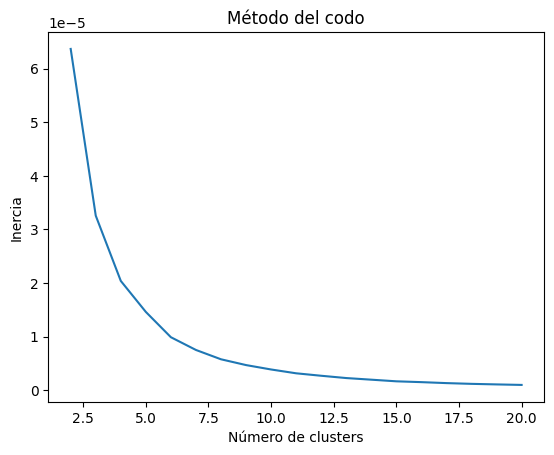

In [50]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

inertia = []
num_clusters_list = range(2, 21)

for num_clusters in num_clusters_list:
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(buy_prices)
    inertia.append(kmeans.inertia_)

plt.plot(num_clusters_list, inertia)
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.title('Método del codo')
plt.show()


In [70]:
support, resistance = support_resistance_levels(trades)

In [71]:
support

[0.003152091567805641,
 0.0031763570162107405,
 0.003213946895424837,
 0.0032516685963954123,
 0.0032715255313743754,
 0.0032875818322040434,
 0.0033030283192350134,
 0.003319269341303598,
 0.003343980392156863,
 0.0033799984894259815]

In [72]:
resistance

[0.0031513018461007598,
 0.003174988888888889,
 0.0032112502944640756,
 0.003252011577424023,
 0.0032724493958351188,
 0.0032884163738813393,
 0.0033039070944419335,
 0.003320819669756663,
 0.0033476654343807767,
 0.0033879308565531474]

In [69]:
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

def find_optimal_clusters(data, max_clusters):
    inertia = []
    for n_clusters in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=n_clusters, n_init=10, random_state=0).fit(data)
        inertia.append(kmeans.inertia_)
    return np.argmin(np.gradient(np.gradient(inertia))) + 1

def support_resistance_levels(trades, max_clusters=10):
    buy_prices = trades.loc[trades['Buyer was maker'] == False, 'Price'].values.reshape(-1, 1)
    sell_prices = trades.loc[trades['Buyer was maker'] == True, 'Price'].values.reshape(-1, 1)

    optimal_buy_clusters = find_optimal_clusters(buy_prices, max_clusters)
    optimal_sell_clusters = find_optimal_clusters(sell_prices, max_clusters)

    kmeans_buy = KMeans(n_clusters=optimal_buy_clusters, n_init=10).fit(buy_prices)
    kmeans_sell = KMeans(n_clusters=optimal_sell_clusters, n_init=10).fit(sell_prices)

    support_levels = np.sort(kmeans_buy.cluster_centers_, axis=0)
    resistance_levels = np.sort(kmeans_sell.cluster_centers_, axis=0)

    return support_levels.flatten().tolist(), resistance_levels.flatten().tolist()